# Goal

The goal of this notebook is to analyze all the data coming back from the multi-objective optimizer optimization exercise.

Specifically, we want to ingest all observations, plot them using DABL, CAVE, and Tomograph.

In [1]:
from IPython.core.display import display, HTML
import dabl
import pandas as pd
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
params_file_path = r"\\adsmiech-pc\share\mlos_data\optimizing_optimizer\params.csv"
objectives_file_path = r"\\adsmiech-pc\share\mlos_data\optimizing_optimizer\objectives.csv"

params_df = pd.read_csv(params_file_path)
objectives_df = pd.read_csv(objectives_file_path)

In [3]:
params_df = params_df[(params_df['fraction_random_suggestions'] <= 0.5) & (params_df['fraction_random_suggestions'] >= 0.2)].reset_index(drop=True)
objectives_df = objectives_df.loc[params_df.index].reset_index(drop=True)

In [4]:
observations_df = pd.concat([params_df, objectives_df], axis=1)
observations_df

,num_decision_trees,samples_fraction_per_tree,bootstrap,n_samples_before_refit,fraction_random_suggestions,numeric_optimizer_implementation,num_monte_carlo_samples,random_search_optimizer_config.num_samples_per_iteration,glow_worm_swarm_optimizer_config.num_initial_points_multiplier,glow_worm_swarm_optimizer_config.num_worms,...,glow_worm_swarm_optimizer_config.luciferin_decay_constant,glow_worm_swarm_optimizer_config.luciferin_enhancement_constant,glow_worm_swarm_optimizer_config.step_size,glow_worm_swarm_optimizer_config.initial_decision_radius,glow_worm_swarm_optimizer_config.max_sensory_radius,glow_worm_swarm_optimizer_config.desired_num_neighbors,glow_worm_swarm_optimizer_config.decision_radius_adjustment_constant,pareto_volume_after_1000_iterations,pareto_volume_after_2000_iterations,duration_s
0,5,0.679205,True,4,0.851484,GlowWormSwarmOptimizer,198,NaN,7.0,223.0,...,0.177506,0.853757,0.969948,0.266173,1.010380,6.0,0.953259,4.375751e+13,6.143670e+13,751.913570
1,5,0.679788,True,15,0.779816,RandomSearchOptimizer,877,2545.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.213882e+13,9.566748e+13,1086.344944
2,10,0.782664,True,1,0.805514,GlowWormSwarmOptimizer,888,NaN,5.0,23.0,...,0.725381,0.981079,0.708563,0.357234,9.750441,88.0,0.551535,5.509444e+13,6.869618e+13,1226.485591
3,5,0.775656,True,1,0.656823,GlowWormSwarmOptimizer,796,NaN,9.0,515.0,...,0.266439,0.829418,0.871992,0.972816,8.000162,61.0,0.408555,5.533966e+13,6.087904e+13,1256.657476
4,17,0.325379,False,2,0.913374,GlowWormSwarmOptimizer,567,NaN,3.0,350.0,...,0.114041,0.482770,0.628174,0.555688,4.373150,51.0,0.383748,4.214678e+13,5.295448e+13,1280.204318
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1981,13,0.762957,True,15,0.254893,GlowWormSwarmOptimizer,574,NaN,10.0,625.0,...,0.043818,0.770142,0.494136,0.086241,6.434018,86.0,0.352400,8.674084e+12,1.417556e+13,9136.881673
1982,18,0.678493,True,1,0.459995,RandomSearchOptimizer,468,45113.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.230207e+12,7.424809e+12,38046.413740
1983,14,0.629362,False,13,0.486900,GlowWormSwarmOptimizer,21,NaN,3.0,204.0,...,0.575041,0.910363,0.653212,0.401354,9.912665,100.0,0.012560,1.289238e+13,1.427032e+13,7657.505927
1984,6,0.465051,False,20,0.451450,GlowWormSwarmOptimizer,452,NaN,8.0,358.0,...,0.376913,0.969254,0.782224,0.719052,4.167246,46.0,0.780326,9.859524e+12,1.817700e+13,3691.690396


In [5]:
observations_df.describe()

,num_decision_trees,samples_fraction_per_tree,n_samples_before_refit,fraction_random_suggestions,num_monte_carlo_samples,random_search_optimizer_config.num_samples_per_iteration,glow_worm_swarm_optimizer_config.num_initial_points_multiplier,glow_worm_swarm_optimizer_config.num_worms,glow_worm_swarm_optimizer_config.num_iterations,glow_worm_swarm_optimizer_config.luciferin_decay_constant,glow_worm_swarm_optimizer_config.luciferin_enhancement_constant,glow_worm_swarm_optimizer_config.step_size,glow_worm_swarm_optimizer_config.initial_decision_radius,glow_worm_swarm_optimizer_config.max_sensory_radius,glow_worm_swarm_optimizer_config.desired_num_neighbors,glow_worm_swarm_optimizer_config.decision_radius_adjustment_constant,pareto_volume_after_1000_iterations,pareto_volume_after_2000_iterations,duration_s
count,1986.000000,1986.000000,1986.000000,1986.000000,1986.000000,833.000000,1153.000000,1153.000000,1153.000000,1153.000000,1153.000000,1153.000000,1153.000000,1153.000000,1153.000000,1153.000000,1.986000e+03,1.986000e+03,1986.000000
mean,11.286002,0.610366,11.504532,0.460218,489.134945,36428.750300,5.998265,493.437988,10.766696,0.506582,0.519580,0.484045,0.519524,5.403340,55.009540,0.510238,2.658027e+13,3.451053e+13,12235.517565
std,4.463203,0.207471,6.170151,0.235240,294.059361,27384.792156,3.018174,288.430950,6.354559,0.294449,0.288481,0.310590,0.288649,3.043946,30.606271,0.279223,2.458725e+13,3.028219e+13,13527.876242
min,5.000000,0.300131,1.000000,0.007397,10.000000,26.000000,1.000000,10.000000,1.000000,0.000237,0.000257,0.000031,0.000162,0.500120,1.000000,0.002090,1.016923e+12,2.645260e+12,358.484478
25%,7.000000,0.416892,6.000000,0.302511,253.250000,13759.000000,3.000000,249.000000,5.000000,0.252852,0.263808,0.192744,0.275545,2.542753,29.000000,0.276417,7.958005e+12,1.120970e+13,3378.190409
50%,11.000000,0.569187,12.000000,0.400987,473.000000,30601.000000,6.000000,485.000000,11.000000,0.506318,0.534197,0.485264,0.533743,5.479253,55.000000,0.530812,1.481584e+13,1.948213e+13,7585.427183
75%,15.000000,0.790314,17.000000,0.488462,736.750000,56966.000000,9.000000,756.000000,17.000000,0.765113,0.772401,0.767231,0.768264,8.157352,83.000000,0.747906,4.385014e+13,6.079805e+13,15802.634169
max,20.000000,0.999826,20.000000,0.999997,1000.000000,99910.000000,10.000000,1000.000000,20.000000,0.999140,0.999878,0.999398,0.998258,9.996232,100.000000,0.999388,1.374848e+14,1.700670e+14,97924.861209


Target looks like regression


c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:629: UserWarning: Dropped 1 outliers in column duration_s.
  warn("Dropped {} outliers in column {}.".format(
c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(
c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(


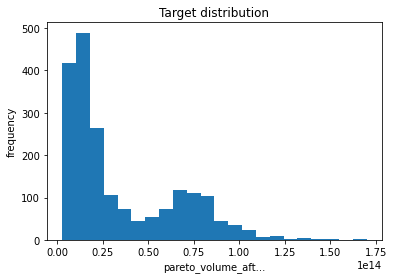

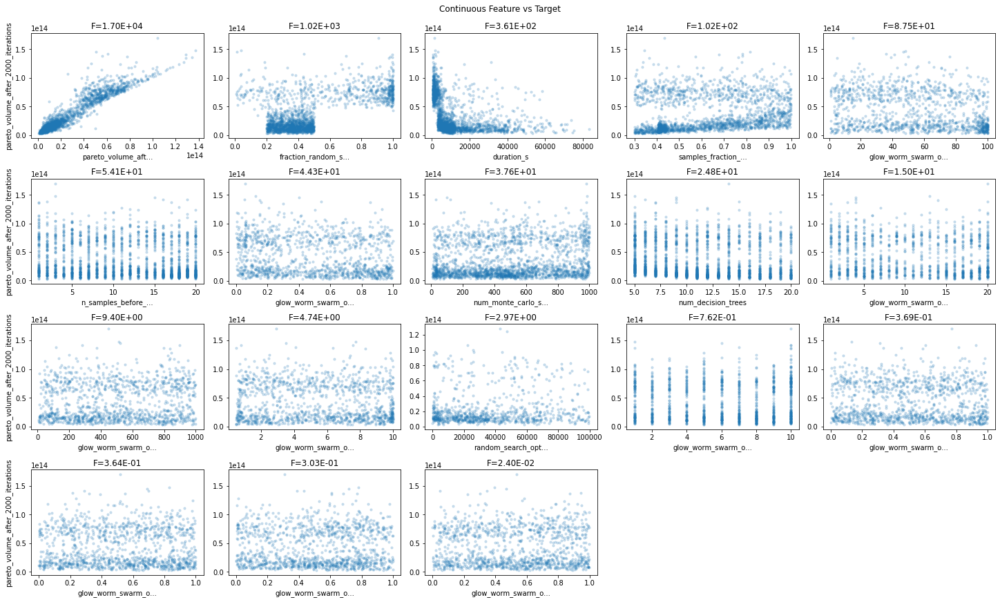

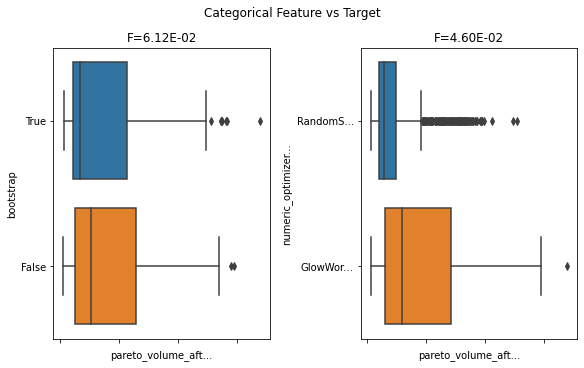

In [6]:
dabl.plot(observations_df, target_col='pareto_volume_after_2000_iterations')

Target looks like regression


c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(
c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(


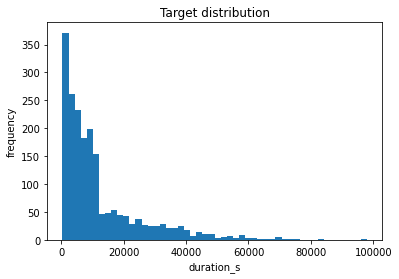

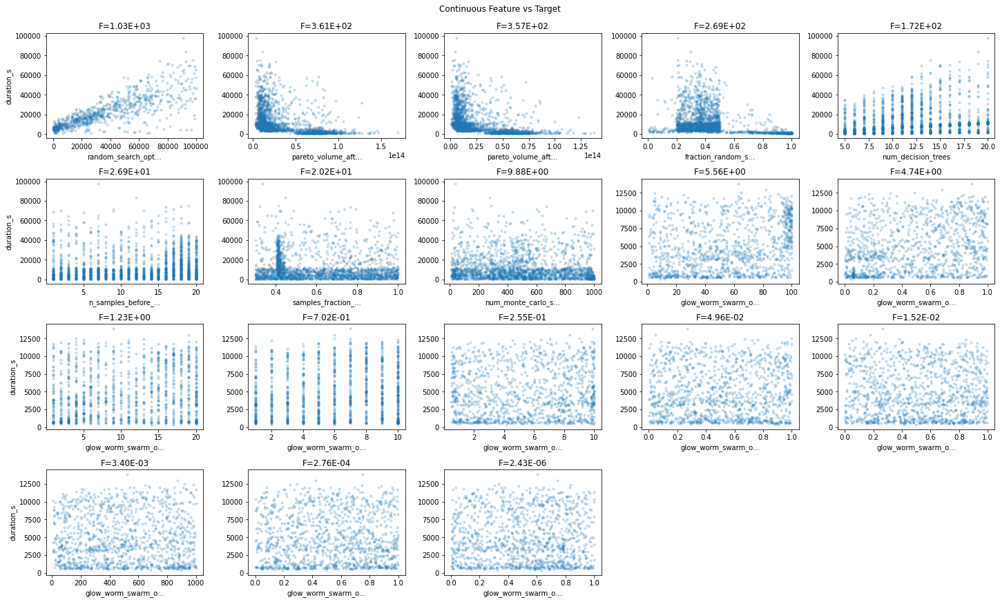

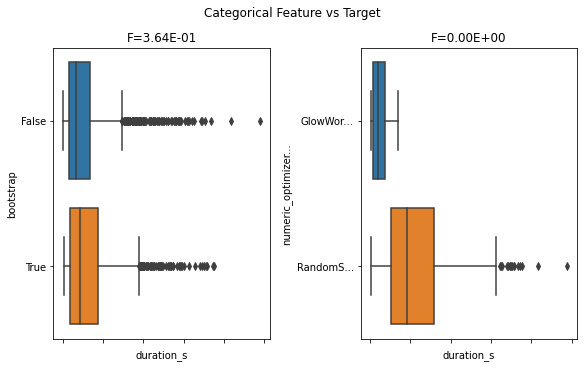

In [7]:
dabl.plot(observations_df, target_col='duration_s')

In [8]:
import math
from mlos.Optimizers.BayesianOptimizerConfigStore import bayesian_optimizer_config_store
from mlos.Optimizers.BayesianOptimizerFactory import BayesianOptimizerFactory
from mlos.Optimizers.ExperimentDesigner.UtilityFunctionOptimizers.GlowWormSwarmOptimizer import GlowWormSwarmOptimizer, glow_worm_swarm_optimizer_config_store
from mlos.Optimizers.ExperimentDesigner.UtilityFunctionOptimizers.RandomSearchOptimizer import RandomSearchOptimizer, random_search_optimizer_config_store
from mlos.Optimizers.OptimizationProblem import Objective, OptimizationProblem
from mlos.Spaces import SimpleHypergrid, Point, CategoricalDimension, ContinuousDimension, DiscreteDimension, OrdinalDimension


target_parameter_space = SimpleHypergrid(
    name="optimizer_parameters",
    dimensions=[
        DiscreteDimension(name="num_decision_trees", min=5, max=20),
        ContinuousDimension(name="samples_fraction_per_tree", min=0.3, max=1),
        CategoricalDimension(name="bootstrap", values=[True, False]),
        DiscreteDimension(name="n_samples_before_refit", min=1, max=20),
        ContinuousDimension(name="fraction_random_suggestions", min=0.2, max=0.5),
        CategoricalDimension('numeric_optimizer_implementation', values=[RandomSearchOptimizer.__name__, GlowWormSwarmOptimizer.__name__]),
        DiscreteDimension(name="num_monte_carlo_samples", min=10, max=1000)
    ]
).join(
        subgrid=random_search_optimizer_config_store.parameter_space,
        on_external_dimension=CategoricalDimension('numeric_optimizer_implementation', values=[RandomSearchOptimizer.__name__])
).join(
    subgrid=glow_worm_swarm_optimizer_config_store.parameter_space,
    on_external_dimension=CategoricalDimension('numeric_optimizer_implementation', values=[GlowWormSwarmOptimizer.__name__])
)

objective_space = SimpleHypergrid(
    name="objective_space",
    dimensions=[
        ContinuousDimension(name="pareto_volume_after_1000_iterations", min=0, max=math.inf),
        ContinuousDimension(name="pareto_volume_after_2000_iterations", min=0, max=math.inf),
        ContinuousDimension(name="duration_s", min=0, max=10*60*60)
    ]
)

optimization_problem = OptimizationProblem(
    parameter_space=target_parameter_space,
    objective_space=objective_space,
    objectives=[
        Objective(name="pareto_volume_after_1000_iterations", minimize=False),
        Objective(name="pareto_volume_after_2000_iterations", minimize=False),
        Objective(name="duration_s", minimize=True)
    ]
)

meta_optimizer_config = bayesian_optimizer_config_store.get_config_by_name("default_multi_objective_optimizer_config")
meta_optimizer_config.homogeneous_random_forest_regression_model_config.features_fraction_per_estimator = 1.0
meta_optimizer_config.homogeneous_random_forest_regression_model_config.n_estimators = 50

meta_optimizer = BayesianOptimizerFactory().create_local_optimizer(
    optimization_problem=optimization_problem,
    optimizer_config=meta_optimizer_config
)


02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 106 -        _create_estimators() ] Creating 50 estimators. Tree config: {
  "criterion": "mse",
  "splitter": "best",
  "max_depth": 0,
  "min_samples_split": 2,
  "min_samples_leaf": 3,
  "min_weight_fraction_leaf": 0,
  "max_features": "auto",
  "max_leaf_nodes": 0,
  "min_impurity_decrease": 0,
  "ccp_alpha": 0,
  "min_samples_to_fit": 10,
  "n_new_samples_before_refit": 10
}. Request id: 0.7233329308477158
02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_0_input_space
  Dimensions:
    contains_context: {False}
    optimizer_parameters___numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    optimizer_parameters__

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_6_input_space
  Dimensions:
    optimizer_parameters___glow_worm_swarm_optimizer_config___desired_num_neighbors: {1, 2, ... , 100}
    optimizer_parameters___glow_worm_swarm_optimizer_config___luciferin_decay_constant: [0.00, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___luciferin_enhancement_constant: [0.00, 1.00]
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
    contains_context: {False}
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_iterations: {1, 2, ... , 20}
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_initial_points_multiplier: {1, 2, ... , 10}
    optimizer_parameters___glow_worm_swarm_optimizer_config___initial_decision_radius: (

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_13_input_space
  Dimensions:
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
    optimizer_parameters___glow_worm_swarm_optimizer_config___decision_radius_adjustment_constant: [0.00, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_worms: {10, 11, ... , 1000}
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___glow_worm_swarm_optimizer_config___luciferin_enhancement_constant: [0.00, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___initial_decision_radius: (0.00, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___desired_num_neighbors: {1, 2, ... , 100}
    contains_context: {False}
    optimize

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_20_input_space
  Dimensions:
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___luciferin_decay_constant: [0.00, 1.00]
    contains_context: {False}
    optimizer_parameters___glow_worm_swarm_optimizer_config___decision_radius_adjustment_constant: [0.00, 1.00]
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_iterations: {1, 2, ... , 20}
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_worms: {10, 11, ... , 1000}
    optimizer_parameters___glow_worm_swarm_optimizer

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_28_input_space
  Dimensions:
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    optimizer_parameters___random_search_optimizer_config___num_samples_per_iteration: {1, 2, ... , 100000}
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    contains_context: {False}
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -  

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_35_input_space
  Dimensions:
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_initial_points_multiplier: {1, 2, ... , 10}
    optimizer_parameters___glow_worm_swarm_optimizer_config___initial_decision_radius: (0.00, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___luciferin_enhancement_constant: [0.00, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_iterations: {1, 2, ... , 20}
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
    optimizer_parameters___glow_worm_swarm_optimizer_config___step_size: [0.00, 1.00]
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    contains_context: {False}
    optimizer_parame

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_42_input_space
  Dimensions:
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    contains_context: {False}
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    optimizer_parameters___random_search_optimizer_config___num_samples_per_iteration: {1, 2, ... , 100000}
    optimizer_parameters___numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -  

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_48_input_space
  Dimensions:
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___random_search_optimizer_config___num_samples_per_iteration: {1, 2, ... , 100000}
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    optimizer_parameters___numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    contains_context: {False}
02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -  

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_4_input_space
  Dimensions:
    optimizer_parameters___glow_worm_swarm_optimizer_config___luciferin_enhancement_constant: [0.00, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___decision_radius_adjustment_constant: [0.00, 1.00]
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_initial_points_multiplier: {1, 2, ... , 10}
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
    optimizer_parameters___glow_worm_swarm_optimizer_config___max_sensory_radius: [0.50, 10.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___step

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_9_input_space
  Dimensions:
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    contains_context: {False}
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    optimizer_parameters___numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    optimizer_parameters___random_search_optimizer_config___num_samples_per_iteration: {1, 2, ... , 100000}
02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -   

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_17_input_space
  Dimensions:
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    optimizer_parameters___glow_worm_swarm_optimizer_config___max_sensory_radius: [0.50, 10.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___luciferin_decay_constant: [0.00, 1.00]
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_worms: {10, 11, ... , 1000}
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
    optimizer_parameters___glow_worm_swarm_optimizer_config___decision_radius_adjustment_constant: [0.00, 1.00]
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_iterations: {1, 2, ... , 

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_23_input_space
  Dimensions:
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    contains_context: {False}
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    optimizer_parameters___numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
    optimizer_parameters___random_search_optimizer_config___num_samples_per_iteration: {1, 2, ... , 100000}
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -  

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_32_input_space
  Dimensions:
    contains_context: {False}
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    optimizer_parameters___numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    optimizer_parameters___random_search_optimizer_config___num_samples_per_iteration: {1, 2, ... , 100000}
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -  

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_39_input_space
  Dimensions:
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_worms: {10, 11, ... , 1000}
    optimizer_parameters___glow_worm_swarm_optimizer_config___luciferin_enhancement_constant: [0.00, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___step_size: [0.00, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___luciferin_decay_constant: [0.00, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___initial_decision_radius: (0.00, 1.00]
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_initial_points_multiplier: {1, 2, ... , 10}
    optimizer_parameters___n_sample

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_46_input_space
  Dimensions:
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___glow_worm_swarm_optimizer_config___step_size: [0.00, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___luciferin_enhancement_constant: [0.00, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___max_sensory_radius: [0.50, 10.00]
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
    optimizer_parameters___glow_worm_swarm_optimizer_config___desired_num_neighbors: {1, 2, ... , 100}
    contains_context: {False}
    optimizer_parameters___glow_worm_swarm_optimizer_config___decision_radius_adjustment_constant: [0.00, 1.00]
    optimizer_parameters_

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_2_input_space
  Dimensions:
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    optimizer_parameters___random_search_optimizer_config___num_samples_per_iteration: {1, 2, ... , 100000}
    optimizer_parameters___numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    contains_context: {False}
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -   

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_9_input_space
  Dimensions:
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_initial_points_multiplier: {1, 2, ... , 10}
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
    optimizer_parameters___numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    optimizer_parameters___glow_worm_swarm_optimizer_config___max_sensory_radius: [0.50, 10.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___luciferin_decay_constant: [0.00, 1.00]
    contains_context: {False}
    optimizer_parameters___fraction_random_sugg

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_15_input_space
  Dimensions:
    contains_context: {False}
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    optimizer_parameters___random_search_optimizer_config___num_samples_per_iteration: {1, 2, ... , 100000}
    optimizer_parameters___numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -  

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_23_input_space
  Dimensions:
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    optimizer_parameters___random_search_optimizer_config___num_samples_per_iteration: {1, 2, ... , 100000}
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
    contains_context: {False}
    optimizer_parameters___numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -  

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_30_input_space
  Dimensions:
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    contains_context: {False}
    optimizer_parameters___numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    optimizer_parameters___glow_worm_swarm_optimizer_config___desired_num_neighbors: {1, 2, ... , 100}
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_initial_points_multiplier: {1, 2, ... , 10}
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
    opt

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_37_input_space
  Dimensions:
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    contains_context: {False}
    optimizer_parameters___numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
    optimizer_parameters___n_samples_before_refit: {1, 2, ... , 20}
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 1000}
    optimizer_parameters___samples_fraction_per_tree: [0.30, 1.00]
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    optimizer_parameters___random_search_optimizer_config___num_samples_per_iteration: {1, 2, ... , 100000}
02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -  

02/10/2021 18:58:54 -   BayesianOptimizerFactory -    INFO - [HomogeneousRandomForestRegressionModel.py: 120 -        _create_estimators() ] Creating DecissionTreeRegressionModel with the input_space:   Name: estimator_45_input_space
  Dimensions:
    optimizer_parameters___numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
    optimizer_parameters___glow_worm_swarm_optimizer_config___max_sensory_radius: [0.50, 10.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___decision_radius_adjustment_constant: [0.00, 1.00]
    optimizer_parameters___glow_worm_swarm_optimizer_config___num_iterations: {1, 2, ... , 20}
    optimizer_parameters___num_decision_trees: {5, 6, ... , 20}
    optimizer_parameters___bootstrap: {True, False}
    optimizer_parameters___glow_worm_swarm_optimizer_config___step_size: [0.00, 1.00]
    optimizer_parameters___fraction_random_suggestions: [0.20, 0.50]
    optimizer_parameters___num_monte_carlo_samples: {10, 11, ... , 10

In [9]:
meta_optimizer_config

{
  "surrogate_model_implementation": "MultiObjectiveHomogeneousRandomForest",
  "experiment_designer_implementation": "ParallelExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 50,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 1,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.splitter": "best",
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.max_depth": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.min_sam

In [10]:
for dimension in target_parameter_space.dimensions:
    print(dimension)

num_decision_trees: {5, 6, ... , 20}
samples_fraction_per_tree: [0.30, 1.00]
bootstrap: {True, False}
n_samples_before_refit: {1, 2, ... , 20}
fraction_random_suggestions: [0.20, 0.50]
numeric_optimizer_implementation: {RandomSearchOptimizer, GlowWormSwarmOptimizer}
num_monte_carlo_samples: {10, 11, ... , 1000}
random_search_optimizer_config.num_samples_per_iteration: {1, 2, ... , 100000}
glow_worm_swarm_optimizer_config.num_initial_points_multiplier: {1, 2, ... , 10}
glow_worm_swarm_optimizer_config.num_worms: {10, 11, ... , 1000}
glow_worm_swarm_optimizer_config.num_iterations: {1, 2, ... , 20}
glow_worm_swarm_optimizer_config.luciferin_decay_constant: [0.00, 1.00]
glow_worm_swarm_optimizer_config.luciferin_enhancement_constant: [0.00, 1.00]
glow_worm_swarm_optimizer_config.step_size: [0.00, 1.00]
glow_worm_swarm_optimizer_config.initial_decision_radius: (0.00, 1.00]
glow_worm_swarm_optimizer_config.max_sensory_radius: [0.50, 10.00]
glow_worm_swarm_optimizer_config.desired_num_neighb

In [11]:
meta_optimizer.register(
    parameter_values_pandas_frame=params_df,
    target_values_pandas_frame=objectives_df
)

02/10/2021 18:59:03 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:03 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:03 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:03 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:03 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:03 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:03 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:03 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:03 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:03 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:04 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:05 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:06 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:07 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:08 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", line 169, in remove_pending_suggestion
    suggestion_id = suggestion["__mlos_metadata"]["suggestion_id"]
  File "e:\code\github_mlos\source\mlos.python\mlos\Spaces\Point.py", line 79, in __getitem__
    raise KeyError(f"This Point does not have a value along dimension: {dimension_name}")
KeyError: 'This Point does not have a value along dimension: __mlos_metadata'
02/10/2021 18:59:09 -   BayesianOptimizerFactory -    INFO - [ParallelExperimentDesigner.py: 173 - remove_pending_suggestion() ] Failed to remove pending suggestion.
Traceback (most recent call last):
  File "e:\code\github_mlos\source\mlos.python\mlos\Optimizers\ExperimentDesigner\ParallelExperimentDesigner.py", li

In [12]:
suggested_config = meta_optimizer.suggest()
print(suggested_config)

mo_predictions = meta_optimizer.predict(suggested_config.to_dataframe())
predicted_observation = {}
for objective_name, prediction in mo_predictions:
    print(objective_name)
    prediction_df = prediction.get_dataframe()
    predicted_observation[objective_name] = prediction_df['predicted_value'][0]
    display(prediction_df)
    
print(predicted_observation)
    
display(meta_optimizer.pareto_frontier.pareto_df)
print(f"Suggestion is dominated: {meta_optimizer.pareto_frontier.is_dominated(Point(**predicted_observation).to_dataframe())}")

{
  "num_decision_trees": 6,
  "samples_fraction_per_tree": 0.4546592819390566,
  "bootstrap": false,
  "n_samples_before_refit": 16,
  "fraction_random_suggestions": 0.49898786580011717,
  "numeric_optimizer_implementation": "GlowWormSwarmOptimizer",
  "num_monte_carlo_samples": 223,
  "glow_worm_swarm_optimizer_config.num_initial_points_multiplier": 5,
  "glow_worm_swarm_optimizer_config.num_worms": 490,
  "glow_worm_swarm_optimizer_config.num_iterations": 1,
  "glow_worm_swarm_optimizer_config.luciferin_decay_constant": 0.06393348858001424,
  "glow_worm_swarm_optimizer_config.luciferin_enhancement_constant": 0.1560035880990892,
  "glow_worm_swarm_optimizer_config.step_size": 0.9872414398623346,
  "glow_worm_swarm_optimizer_config.initial_decision_radius": 0.05841500944057443,
  "glow_worm_swarm_optimizer_config.max_sensory_radius": 4.166156855859246,
  "glow_worm_swarm_optimizer_config.desired_num_neighbors": 3,
  "glow_worm_swarm_optimizer_config.decision_radius_adjustment_constant

,is_valid_input,predicted_value,predicted_value_variance,sample_variance,sample_size,predicted_value_degrees_of_freedom
0,True,2.904942e+13,6.732166e+26,8.497775e+26,24,74.0


pareto_volume_after_2000_iterations


,is_valid_input,predicted_value,predicted_value_variance,sample_variance,sample_size,predicted_value_degrees_of_freedom
0,True,5.232559e+13,8.253314e+26,1.031615e+27,25,69.0


duration_s


,is_valid_input,predicted_value,predicted_value_variance,sample_variance,sample_size,predicted_value_degrees_of_freedom
0,True,2357.380936,929450.270325,1.482775e+06,20,60.0


{'pareto_volume_after_1000_iterations': 29049416387435.613, 'pareto_volume_after_2000_iterations': 52325588971929.93, 'duration_s': 2357.380935785}


,pareto_volume_after_1000_iterations,pareto_volume_after_2000_iterations,duration_s
569,6.167212e+13,6.872369e+13,2064.996537
401,5.807419e+13,7.049703e+13,3638.252928
123,5.537330e+13,7.416201e+13,7752.247356
505,5.280405e+13,7.453770e+13,6163.279881
169,4.913247e+13,8.368342e+13,2554.421751


Suggestion is dominated: 0    True
dtype: bool


In [13]:
meta_optimizer.add_pending_suggestion(suggested_config)

In [14]:
meta_optimizer.experiment_designer._pending_suggestions = {}
meta_optimizer.experiment_designer._update_tentative_pareto()

In [15]:
tentative_pareto_df = meta_optimizer.experiment_designer._tentative_pareto_frontier.pareto_df
display(tentative_pareto_df)

,pareto_volume_after_1000_iterations,pareto_volume_after_2000_iterations,duration_s
569,6.167212e+13,6.872369e+13,2064.996537
401,5.807419e+13,7.049703e+13,3638.252928
123,5.537330e+13,7.416201e+13,7752.247356
505,5.280405e+13,7.453770e+13,6163.279881
169,4.913247e+13,8.368342e+13,2554.421751


In [16]:
import plotly.express as px


fig = px.scatter(
    tentative_pareto_df,
    x=tentative_pareto_df['pareto_volume_after_1000_iterations'],
    y=tentative_pareto_df['duration_s'],
    width=1000,
    height=1000
)


fig.show()

In [17]:
import plotly.express as px


fig = px.scatter_3d(
    tentative_pareto_df,
    x=tentative_pareto_df['pareto_volume_after_1000_iterations'],
    y=tentative_pareto_df['duration_s'],
    z=tentative_pareto_df['pareto_volume_after_2000_iterations'],
    width=1000,
    height=1000
)


fig.show()

In [18]:
import plotly.express as px


fig = px.scatter(
    tentative_pareto_df,
    x=tentative_pareto_df['pareto_volume_after_1000_iterations'],
    y=tentative_pareto_df['duration_s'],
    width=1000,
    height=1000
)


fig.show()

In [19]:
import os
os.getpid()

20392

In [20]:
pareto_frontier = meta_optimizer.pareto_frontier

In [21]:
_, targets, _ = meta_optimizer.get_all_observations()
targets

,pareto_volume_after_1000_iterations,pareto_volume_after_2000_iterations,duration_s
0,4.375751e+13,6.143670e+13,751.913570
1,7.213882e+13,9.566748e+13,1086.344944
2,5.509444e+13,6.869618e+13,1226.485591
3,5.533966e+13,6.087904e+13,1256.657476
4,4.214678e+13,5.295448e+13,1280.204318
...,...,...,...
1981,8.674084e+12,1.417556e+13,9136.881673
1982,5.230207e+12,7.424809e+12,38046.413740
1983,1.289238e+13,1.427032e+13,7657.505927
1984,9.859524e+12,1.817700e+13,3691.690396


In [22]:
observations_df

,num_decision_trees,samples_fraction_per_tree,bootstrap,n_samples_before_refit,fraction_random_suggestions,numeric_optimizer_implementation,num_monte_carlo_samples,random_search_optimizer_config.num_samples_per_iteration,glow_worm_swarm_optimizer_config.num_initial_points_multiplier,glow_worm_swarm_optimizer_config.num_worms,...,glow_worm_swarm_optimizer_config.luciferin_decay_constant,glow_worm_swarm_optimizer_config.luciferin_enhancement_constant,glow_worm_swarm_optimizer_config.step_size,glow_worm_swarm_optimizer_config.initial_decision_radius,glow_worm_swarm_optimizer_config.max_sensory_radius,glow_worm_swarm_optimizer_config.desired_num_neighbors,glow_worm_swarm_optimizer_config.decision_radius_adjustment_constant,pareto_volume_after_1000_iterations,pareto_volume_after_2000_iterations,duration_s
0,5,0.679205,True,4,0.851484,GlowWormSwarmOptimizer,198,NaN,7.0,223.0,...,0.177506,0.853757,0.969948,0.266173,1.010380,6.0,0.953259,4.375751e+13,6.143670e+13,751.913570
1,5,0.679788,True,15,0.779816,RandomSearchOptimizer,877,2545.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.213882e+13,9.566748e+13,1086.344944
2,10,0.782664,True,1,0.805514,GlowWormSwarmOptimizer,888,NaN,5.0,23.0,...,0.725381,0.981079,0.708563,0.357234,9.750441,88.0,0.551535,5.509444e+13,6.869618e+13,1226.485591
3,5,0.775656,True,1,0.656823,GlowWormSwarmOptimizer,796,NaN,9.0,515.0,...,0.266439,0.829418,0.871992,0.972816,8.000162,61.0,0.408555,5.533966e+13,6.087904e+13,1256.657476
4,17,0.325379,False,2,0.913374,GlowWormSwarmOptimizer,567,NaN,3.0,350.0,...,0.114041,0.482770,0.628174,0.555688,4.373150,51.0,0.383748,4.214678e+13,5.295448e+13,1280.204318
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1981,13,0.762957,True,15,0.254893,GlowWormSwarmOptimizer,574,NaN,10.0,625.0,...,0.043818,0.770142,0.494136,0.086241,6.434018,86.0,0.352400,8.674084e+12,1.417556e+13,9136.881673
1982,18,0.678493,True,1,0.459995,RandomSearchOptimizer,468,45113.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.230207e+12,7.424809e+12,38046.413740
1983,14,0.629362,False,13,0.486900,GlowWormSwarmOptimizer,21,NaN,3.0,204.0,...,0.575041,0.910363,0.653212,0.401354,9.912665,100.0,0.012560,1.289238e+13,1.427032e+13,7657.505927
1984,6,0.465051,False,20,0.451450,GlowWormSwarmOptimizer,452,NaN,8.0,358.0,...,0.376913,0.969254,0.782224,0.719052,4.167246,46.0,0.780326,9.859524e+12,1.817700e+13,3691.690396


In [23]:
observations_df.describe()

,num_decision_trees,samples_fraction_per_tree,n_samples_before_refit,fraction_random_suggestions,num_monte_carlo_samples,random_search_optimizer_config.num_samples_per_iteration,glow_worm_swarm_optimizer_config.num_initial_points_multiplier,glow_worm_swarm_optimizer_config.num_worms,glow_worm_swarm_optimizer_config.num_iterations,glow_worm_swarm_optimizer_config.luciferin_decay_constant,glow_worm_swarm_optimizer_config.luciferin_enhancement_constant,glow_worm_swarm_optimizer_config.step_size,glow_worm_swarm_optimizer_config.initial_decision_radius,glow_worm_swarm_optimizer_config.max_sensory_radius,glow_worm_swarm_optimizer_config.desired_num_neighbors,glow_worm_swarm_optimizer_config.decision_radius_adjustment_constant,pareto_volume_after_1000_iterations,pareto_volume_after_2000_iterations,duration_s
count,1986.000000,1986.000000,1986.000000,1986.000000,1986.000000,833.000000,1153.000000,1153.000000,1153.000000,1153.000000,1153.000000,1153.000000,1153.000000,1153.000000,1153.000000,1153.000000,1.986000e+03,1.986000e+03,1986.000000
mean,11.286002,0.610366,11.504532,0.460218,489.134945,36428.750300,5.998265,493.437988,10.766696,0.506582,0.519580,0.484045,0.519524,5.403340,55.009540,0.510238,2.658027e+13,3.451053e+13,12235.517565
std,4.463203,0.207471,6.170151,0.235240,294.059361,27384.792156,3.018174,288.430950,6.354559,0.294449,0.288481,0.310590,0.288649,3.043946,30.606271,0.279223,2.458725e+13,3.028219e+13,13527.876242
min,5.000000,0.300131,1.000000,0.007397,10.000000,26.000000,1.000000,10.000000,1.000000,0.000237,0.000257,0.000031,0.000162,0.500120,1.000000,0.002090,1.016923e+12,2.645260e+12,358.484478
25%,7.000000,0.416892,6.000000,0.302511,253.250000,13759.000000,3.000000,249.000000,5.000000,0.252852,0.263808,0.192744,0.275545,2.542753,29.000000,0.276417,7.958005e+12,1.120970e+13,3378.190409
50%,11.000000,0.569187,12.000000,0.400987,473.000000,30601.000000,6.000000,485.000000,11.000000,0.506318,0.534197,0.485264,0.533743,5.479253,55.000000,0.530812,1.481584e+13,1.948213e+13,7585.427183
75%,15.000000,0.790314,17.000000,0.488462,736.750000,56966.000000,9.000000,756.000000,17.000000,0.765113,0.772401,0.767231,0.768264,8.157352,83.000000,0.747906,4.385014e+13,6.079805e+13,15802.634169
max,20.000000,0.999826,20.000000,0.999997,1000.000000,99910.000000,10.000000,1000.000000,20.000000,0.999140,0.999878,0.999398,0.998258,9.996232,100.000000,0.999388,1.374848e+14,1.700670e+14,97924.861209


In [24]:
pareto_frontier.pareto_df

,pareto_volume_after_1000_iterations,pareto_volume_after_2000_iterations,duration_s
569,6.167212e+13,6.872369e+13,2064.996537
401,5.807419e+13,7.049703e+13,3638.252928
123,5.537330e+13,7.416201e+13,7752.247356
505,5.280405e+13,7.453770e+13,6163.279881
169,4.913247e+13,8.368342e+13,2554.421751


In [25]:
import plotly.express as px


pareto_df = pareto_frontier.pareto_df
observations_df['is_pareto'] = False
observations_df['duration_s_inverse'] = 1 / observations_df['duration_s']
observations_df['negative_duration_s'] = -observations_df['duration_s']
observations_df.loc[pareto_df.index, 'is_pareto'] = True
observations_df['index'] = observations_df.index

fig = px.scatter(
    observations_df,
    x=observations_df['pareto_volume_after_1000_iterations'],
    y=observations_df['negative_duration_s'],
    color=observations_df['index'],
    hover_data=[column for column in observations_df.columns],
    width=1000,
    height=1000
)
#fig.update_traces(mode="markers", hovertemplate=None)

fig.show()

In [26]:
import os
os.getpid()

20392

In [27]:
# Let's see if we can plot a speculative pareto.
#
random_params_df = target_parameter_space.random_dataframe(20000)
random_features_df = optimization_problem.construct_feature_dataframe(random_params_df)
mo_predictions = meta_optimizer.surrogate_model.predict(random_features_df)
predicted_objectives_df = pd.DataFrame()
for objective_name, prediction in mo_predictions:
    predicted_objectives_df[objective_name] = prediction.get_dataframe()['predicted_value']

In [28]:
predicted_observations_df = pd.concat([random_params_df, predicted_objectives_df], axis=1)

In [29]:
predicted_observations_df

,num_decision_trees,samples_fraction_per_tree,bootstrap,n_samples_before_refit,fraction_random_suggestions,numeric_optimizer_implementation,num_monte_carlo_samples,glow_worm_swarm_optimizer_config.num_initial_points_multiplier,glow_worm_swarm_optimizer_config.num_worms,glow_worm_swarm_optimizer_config.num_iterations,...,glow_worm_swarm_optimizer_config.luciferin_enhancement_constant,glow_worm_swarm_optimizer_config.step_size,glow_worm_swarm_optimizer_config.initial_decision_radius,glow_worm_swarm_optimizer_config.max_sensory_radius,glow_worm_swarm_optimizer_config.desired_num_neighbors,glow_worm_swarm_optimizer_config.decision_radius_adjustment_constant,random_search_optimizer_config.num_samples_per_iteration,pareto_volume_after_1000_iterations,pareto_volume_after_2000_iterations,duration_s
0,14,0.911638,True,9,0.432736,GlowWormSwarmOptimizer,538,9.0,252.0,2.0,...,0.132193,0.591398,0.211161,5.167235,85.0,0.947987,NaN,2.000488e+13,2.261338e+13,7501.238003
1,11,0.646695,False,9,0.403127,GlowWormSwarmOptimizer,991,10.0,984.0,10.0,...,0.787685,0.004210,0.076876,0.741318,59.0,0.607526,NaN,3.272309e+13,6.212610e+13,6621.064727
2,17,0.646307,False,14,0.298457,RandomSearchOptimizer,141,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,34688.0,1.331755e+13,1.858866e+13,34755.456899
3,20,0.849116,False,20,0.450258,GlowWormSwarmOptimizer,556,7.0,250.0,14.0,...,0.228178,0.679032,0.457798,9.495794,63.0,0.248833,NaN,2.201717e+13,2.388922e+13,10697.039954
4,8,0.587505,False,2,0.318761,GlowWormSwarmOptimizer,915,8.0,216.0,10.0,...,0.775717,0.530387,0.940028,9.513264,36.0,0.400832,NaN,1.294002e+13,2.291335e+13,4086.981381
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19995,7,0.377441,True,8,0.335889,GlowWormSwarmOptimizer,487,5.0,81.0,1.0,...,0.175353,0.591777,0.757049,9.898138,65.0,0.296567,NaN,1.177548e+13,1.206806e+13,4127.826445
19996,14,0.994205,True,7,0.253317,RandomSearchOptimizer,785,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,67160.0,4.097087e+13,4.009789e+13,49822.844458
19997,10,0.405194,False,12,0.384156,GlowWormSwarmOptimizer,42,1.0,811.0,16.0,...,0.856884,0.482362,0.888449,9.124399,68.0,0.295334,NaN,1.010652e+13,9.648648e+12,5551.441036
19998,9,0.902887,False,8,0.366212,GlowWormSwarmOptimizer,304,4.0,540.0,18.0,...,0.376624,0.905913,0.935502,9.761124,20.0,0.292258,NaN,3.013995e+13,4.176166e+13,4502.437146


In [30]:
from mlos.Optimizers.ParetoFrontier import ParetoFrontier

speculative_pareto = ParetoFrontier(optimization_problem=optimization_problem, objectives_df=predicted_objectives_df)
speculative_pareto_df = speculative_pareto.pareto_df

In [31]:
speculative_pareto_df

,pareto_volume_after_1000_iterations,pareto_volume_after_2000_iterations,duration_s
2801,5.648464e+13,4.556886e+13,7409.176552
4094,5.521470e+13,6.178426e+13,8217.560951
8343,5.232348e+13,4.243969e+13,5148.354409
14250,5.029176e+13,4.871331e+13,7256.984008
4298,4.896656e+13,6.138713e+13,3827.401665
10196,4.521812e+13,6.599445e+13,5080.880374
13559,4.445630e+13,6.348706e+13,3834.763261
14423,4.354817e+13,6.759086e+13,4245.217380
19299,4.295577e+13,6.147073e+13,2998.873351
11089,4.255338e+13,7.062783e+13,4341.496941


In [32]:
import plotly.express as px

predicted_observations_df['duration_s_inverse'] = 1 / predicted_observations_df['duration_s']
predicted_observations_df['is_pareto'] = False
predicted_observations_df.loc[speculative_pareto_df.index, 'is_pareto'] = True

fig = px.scatter_3d(
    predicted_observations_df,
    x=predicted_observations_df['pareto_volume_after_2000_iterations'],
    y=predicted_observations_df['duration_s'],
    z=predicted_observations_df['pareto_volume_after_1000_iterations'],
    hover_data=[column for column in predicted_observations_df.columns],
    color=predicted_observations_df['is_pareto'],
    width=1000,
    height=1000
)
#fig.update_traces(mode="markers", hovertemplate=None)

fig.show()

In [33]:
display(predicted_observations_df[predicted_observations_df['is_pareto']])

,num_decision_trees,samples_fraction_per_tree,bootstrap,n_samples_before_refit,fraction_random_suggestions,numeric_optimizer_implementation,num_monte_carlo_samples,glow_worm_swarm_optimizer_config.num_initial_points_multiplier,glow_worm_swarm_optimizer_config.num_worms,glow_worm_swarm_optimizer_config.num_iterations,...,glow_worm_swarm_optimizer_config.initial_decision_radius,glow_worm_swarm_optimizer_config.max_sensory_radius,glow_worm_swarm_optimizer_config.desired_num_neighbors,glow_worm_swarm_optimizer_config.decision_radius_adjustment_constant,random_search_optimizer_config.num_samples_per_iteration,pareto_volume_after_1000_iterations,pareto_volume_after_2000_iterations,duration_s,duration_s_inverse,is_pareto
2801,9,0.996780,False,19,0.262856,RandomSearchOptimizer,559,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,6598.0,5.648464e+13,4.556886e+13,7409.176552,0.000135,True
4094,16,0.827053,True,4,0.290816,GlowWormSwarmOptimizer,124,6.0,147.0,20.0,...,0.911479,8.007238,8.0,0.015577,NaN,5.521470e+13,6.178426e+13,8217.560951,0.000122,True
4298,6,0.823981,True,7,0.344137,GlowWormSwarmOptimizer,672,7.0,469.0,19.0,...,0.075416,6.405842,76.0,0.039562,NaN,4.896656e+13,6.138713e+13,3827.401665,0.000261,True
6854,6,0.657441,False,1,0.492581,GlowWormSwarmOptimizer,578,1.0,425.0,1.0,...,0.773268,2.178889,94.0,0.842396,NaN,3.442608e+13,4.752425e+13,2674.986270,0.000374,True
7287,7,0.378190,True,10,0.258316,GlowWormSwarmOptimizer,198,10.0,639.0,12.0,...,0.418086,1.275438,80.0,0.877903,NaN,2.555864e+13,6.791470e+13,4289.370463,0.000233,True
7554,5,0.737326,True,19,0.477628,GlowWormSwarmOptimizer,467,2.0,367.0,2.0,...,0.521428,0.983835,8.0,0.670725,NaN,3.712655e+13,5.835004e+13,2954.207158,0.000339,True
7690,5,0.502722,True,2,0.421802,GlowWormSwarmOptimizer,692,2.0,296.0,7.0,...,0.425955,8.427785,59.0,0.845319,NaN,2.855738e+13,5.233869e+13,2514.360335,0.000398,True
8343,6,0.997451,True,9,0.348183,RandomSearchOptimizer,41,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,4560.0,5.232348e+13,4.243969e+13,5148.354409,0.000194,True
9648,5,0.325877,False,5,0.234395,GlowWormSwarmOptimizer,695,5.0,62.0,15.0,...,0.820701,1.150103,90.0,0.612347,NaN,2.762284e+13,6.230499e+13,2953.486455,0.000339,True
10196,12,0.806420,True,10,0.484643,GlowWormSwarmOptimizer,416,2.0,340.0,16.0,...,0.154759,5.859199,12.0,0.046787,NaN,4.521812e+13,6.599445e+13,5080.880374,0.000197,True


c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\preprocessing.py:351: UserWarning:

Discarding near-constant features: ['is_pareto']



Target looks like regression


c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator

c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator

c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator

c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator

c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator



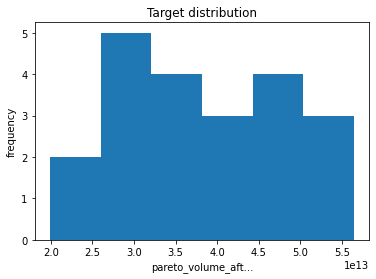

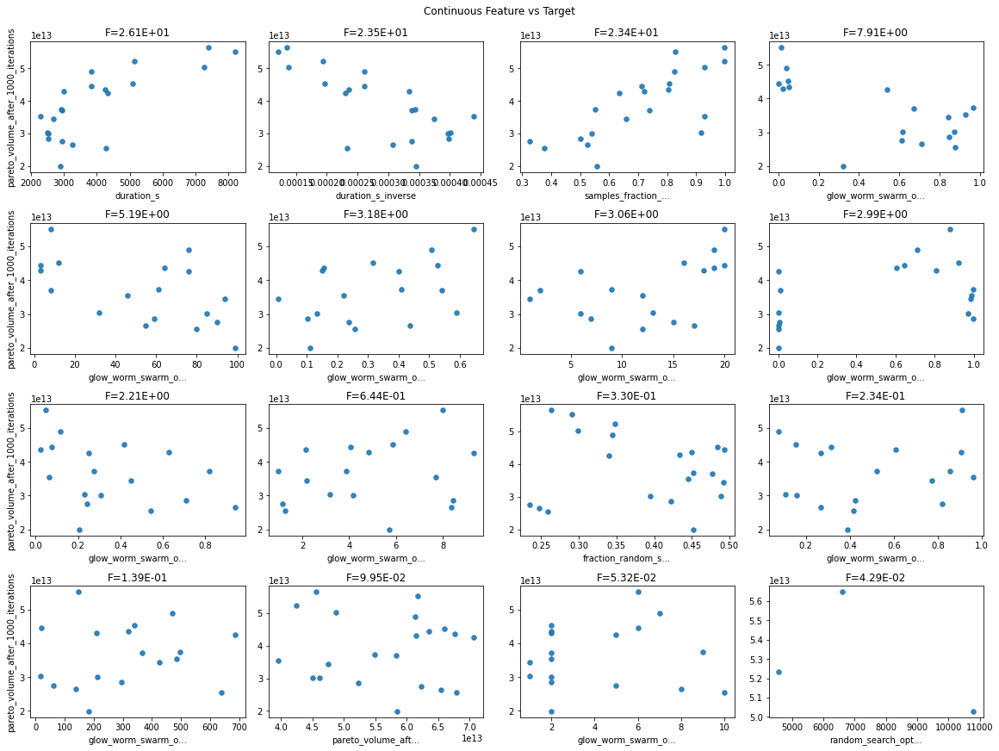

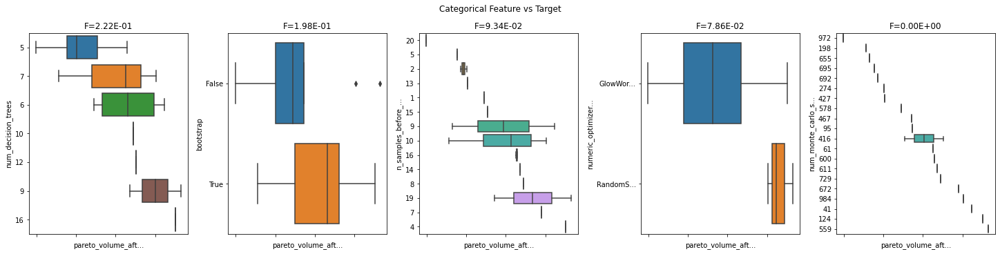

In [34]:
dabl.plot(predicted_observations_df[predicted_observations_df['is_pareto']], target_col='pareto_volume_after_1000_iterations')

c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\preprocessing.py:351: UserWarning:

Discarding near-constant features: ['is_pareto']



Target looks like regression


c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator

c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator

c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator

c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator

c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator



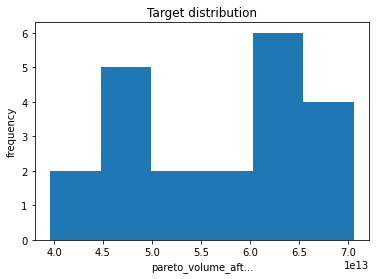

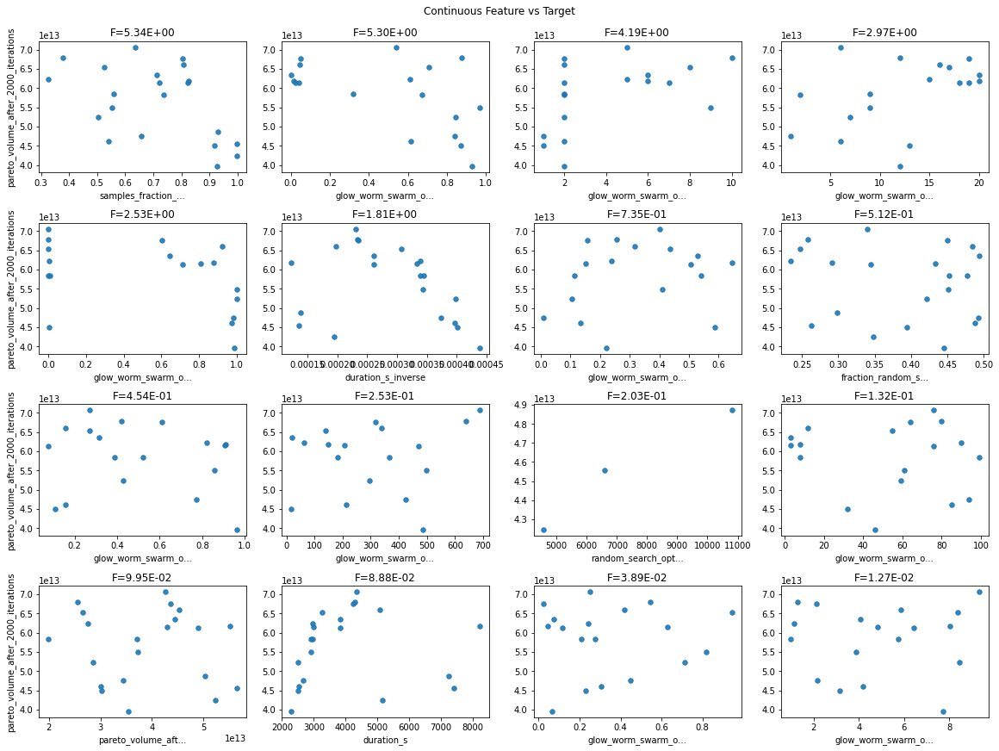

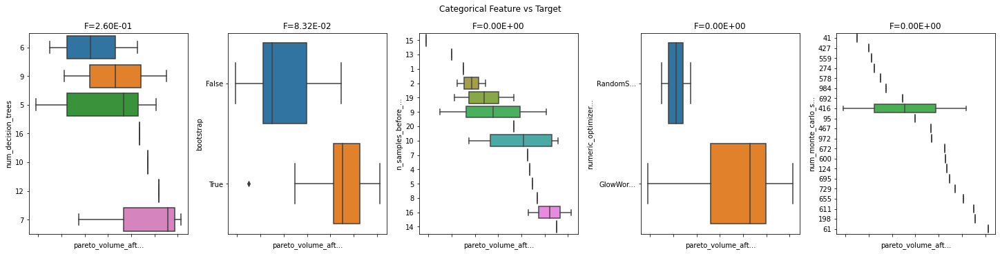

In [35]:
dabl.plot(predicted_observations_df[predicted_observations_df['is_pareto']], target_col='pareto_volume_after_2000_iterations')

c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\preprocessing.py:351: UserWarning:

Discarding near-constant features: ['is_pareto']



Target looks like regression


c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator

c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator

c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator

c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator

c:\users\adsmiech\appdata\local\programs\python\python38-32\lib\site-packages\dabl\plot\utils.py:371: UserWarning:

FixedFormatter should only be used together with FixedLocator



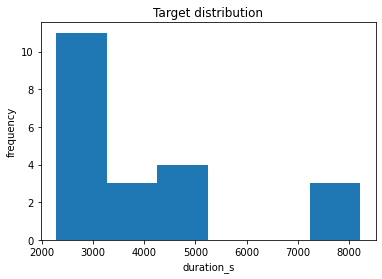

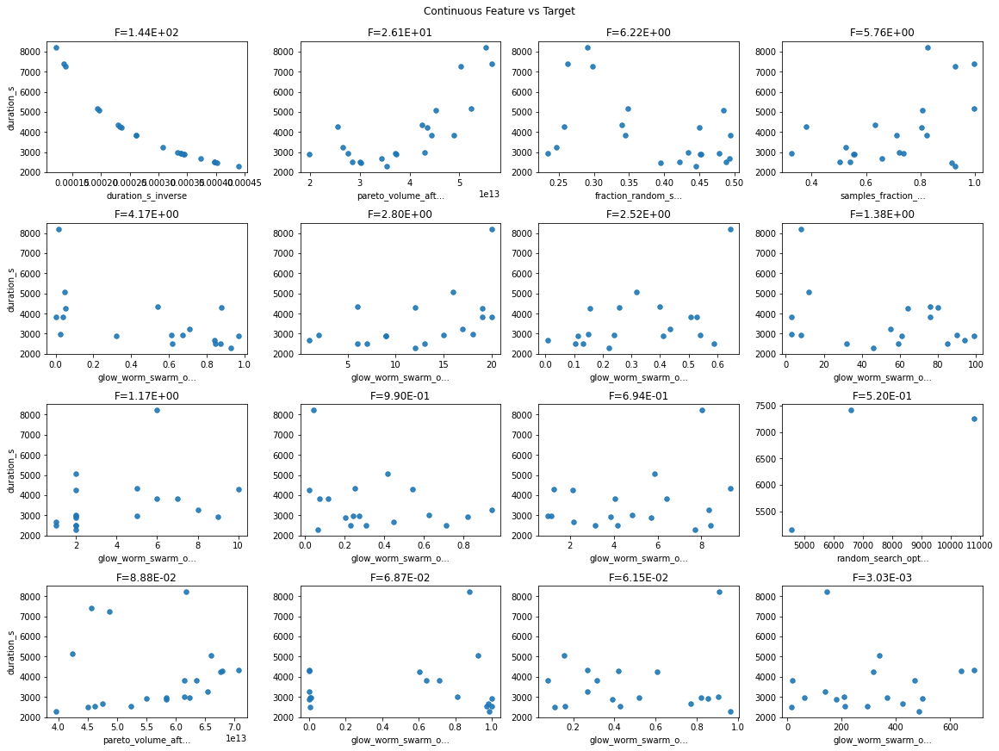

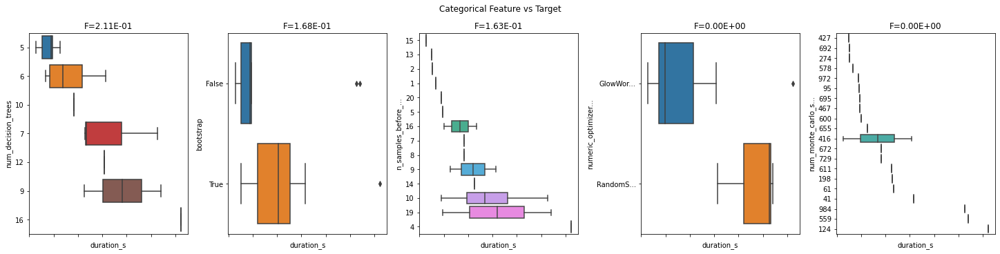

In [36]:
dabl.plot(predicted_observations_df[predicted_observations_df['is_pareto']], target_col='duration_s')

In [37]:
import plotly.express as px

observations_df['is_pareto'] = False
observations_df['duration_s_inverse'] = 1 / observations_df['duration_s']
observations_df['pareto_volume_after_2000_iterations_inverse'] = 1 / observations_df['pareto_volume_after_2000_iterations']
observations_df.loc[pareto_frontier.pareto_df.index, 'is_pareto'] = True

fig = px.scatter(
    observations_df,
    x=observations_df['pareto_volume_after_2000_iterations'],
    y=observations_df['duration_s'],
    color=observations_df.index,
    hover_data=[column for column in observations_df.columns],
    width=1000,
    height=1000
)
#fig.update_traces(mode="markers", hovertemplate=None)

fig.show()

In [38]:
import plotly.express as px

observations_df['is_pareto'] = False
observations_df.loc[pareto_frontier.pareto_df.index, 'is_pareto'] = True

fig = px.scatter_3d(
    observations_df,
    x=observations_df['pareto_volume_after_1000_iterations'],
    y=observations_df['pareto_volume_after_2000_iterations'],
    z=observations_df['negative_duration_s'],
    color=observations_df.index,
    symbol=observations_df['is_pareto'],
    hover_data=[column for column in observations_df.columns],
    width=1200,
    height=1200
)
#fig.update_traces(mode="markers", hovertemplate=None)

fig.show()

In [60]:
import numpy as np
# Let's plot predictions for each of the observations
#
mo_predictions = meta_optimizer.predict(params_df)
predictions_for_observations_df = pd.DataFrame()

for objective_name, prediction in mo_predictions:
    prediction_df = prediction.get_dataframe()
    predictions_for_observations_df[f"predicted_{objective_name}"] = prediction_df['predicted_value']
    
predictions_for_observations_df = pd.concat([predictions_for_observations_df, observations_df], axis=1)

In [62]:
display(predictions_for_observations_df)

,predicted_pareto_volume_after_1000_iterations,predicted_pareto_volume_after_2000_iterations,predicted_duration_s,num_decision_trees,samples_fraction_per_tree,bootstrap,n_samples_before_refit,fraction_random_suggestions,numeric_optimizer_implementation,num_monte_carlo_samples,...,glow_worm_swarm_optimizer_config.desired_num_neighbors,glow_worm_swarm_optimizer_config.decision_radius_adjustment_constant,pareto_volume_after_1000_iterations,pareto_volume_after_2000_iterations,duration_s,is_pareto,duration_s_inverse,negative_duration_s,index,pareto_volume_after_2000_iterations_inverse
0,NaN,NaN,NaN,5,0.679205,True,4,0.851484,GlowWormSwarmOptimizer,198,...,6.0,0.953259,4.375751e+13,6.143670e+13,751.913570,False,0.001330,-751.913570,0,1.627692e-14
1,NaN,NaN,NaN,5,0.679788,True,15,0.779816,RandomSearchOptimizer,877,...,NaN,NaN,7.213882e+13,9.566748e+13,1086.344944,False,0.000921,-1086.344944,1,1.045287e-14
2,NaN,NaN,NaN,10,0.782664,True,1,0.805514,GlowWormSwarmOptimizer,888,...,88.0,0.551535,5.509444e+13,6.869618e+13,1226.485591,False,0.000815,-1226.485591,2,1.455685e-14
3,NaN,NaN,NaN,5,0.775656,True,1,0.656823,GlowWormSwarmOptimizer,796,...,61.0,0.408555,5.533966e+13,6.087904e+13,1256.657476,False,0.000796,-1256.657476,3,1.642602e-14
4,NaN,NaN,NaN,17,0.325379,False,2,0.913374,GlowWormSwarmOptimizer,567,...,51.0,0.383748,4.214678e+13,5.295448e+13,1280.204318,False,0.000781,-1280.204318,4,1.888414e-14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1981,1.046240e+13,1.776933e+13,8521.937736,13,0.762957,True,15,0.254893,GlowWormSwarmOptimizer,574,...,86.0,0.352400,8.674084e+12,1.417556e+13,9136.881673,False,0.000109,-9136.881673,1981,7.054397e-14
1982,7.905832e+12,8.536500e+12,37774.846028,18,0.678493,True,1,0.459995,RandomSearchOptimizer,468,...,NaN,NaN,5.230207e+12,7.424809e+12,38046.413740,False,0.000026,-38046.413740,1982,1.346836e-13
1983,1.228800e+13,1.458570e+13,7366.657130,14,0.629362,False,13,0.486900,GlowWormSwarmOptimizer,21,...,100.0,0.012560,1.289238e+13,1.427032e+13,7657.505927,False,0.000131,-7657.505927,1983,7.007553e-14
1984,1.264386e+13,2.355683e+13,3688.953200,6,0.465051,False,20,0.451450,GlowWormSwarmOptimizer,452,...,46.0,0.780326,9.859524e+12,1.817700e+13,3691.690396,False,0.000271,-3691.690396,1984,5.501458e-14


In [53]:
for objective_name, _ in mo_predictions:
    predictions_for_observations_df[f"{objective_name}_prediction_error"] = predictions_for_observations_df[objective_name] - predictions_for_observations_df[f"predicted_{objective_name}"]
    predictions_for_observations_df[f"{objective_name}_percentage_error"] = np.abs(predictions_for_observations_df[f"{objective_name}_prediction_error"] / predictions_for_observations_df[objective_name])

In [59]:
predictions_for_observations_df

,predicted_pareto_volume_after_1000_iterations,predicted_pareto_volume_after_2000_iterations,predicted_duration_s,num_decision_trees,samples_fraction_per_tree,bootstrap,n_samples_before_refit,fraction_random_suggestions,numeric_optimizer_implementation,num_monte_carlo_samples,...,duration_s_inverse,negative_duration_s,index,pareto_volume_after_2000_iterations_inverse,pareto_volume_after_1000_iterations_prediction_error,pareto_volume_after_1000_iterations_percentage_error,pareto_volume_after_2000_iterations_prediction_error,pareto_volume_after_2000_iterations_percentage_error,duration_s_prediction_error,duration_s_percentage_error
0,NaN,NaN,NaN,5,0.679205,True,4,0.851484,GlowWormSwarmOptimizer,198,...,0.001330,-751.913570,0,1.627692e-14,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,5,0.679788,True,15,0.779816,RandomSearchOptimizer,877,...,0.000921,-1086.344944,1,1.045287e-14,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,10,0.782664,True,1,0.805514,GlowWormSwarmOptimizer,888,...,0.000815,-1226.485591,2,1.455685e-14,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,5,0.775656,True,1,0.656823,GlowWormSwarmOptimizer,796,...,0.000796,-1256.657476,3,1.642602e-14,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,17,0.325379,False,2,0.913374,GlowWormSwarmOptimizer,567,...,0.000781,-1280.204318,4,1.888414e-14,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1981,1.046240e+13,1.776933e+13,8521.937736,13,0.762957,True,15,0.254893,GlowWormSwarmOptimizer,574,...,0.000109,-9136.881673,1981,7.054397e-14,-1.788319e+12,0.206168,-3.593777e+12,0.253519,614.943937,0.067303
1982,7.905832e+12,8.536500e+12,37774.846028,18,0.678493,True,1,0.459995,RandomSearchOptimizer,468,...,0.000026,-38046.413740,1982,1.346836e-13,-2.675624e+12,0.511571,-1.111691e+12,0.149726,271.567712,0.007138
1983,1.228800e+13,1.458570e+13,7366.657130,14,0.629362,False,13,0.486900,GlowWormSwarmOptimizer,21,...,0.000131,-7657.505927,1983,7.007553e-14,6.043756e+11,0.046879,-3.153881e+11,0.022101,290.848797,0.037982
1984,1.264386e+13,2.355683e+13,3688.953200,6,0.465051,False,20,0.451450,GlowWormSwarmOptimizer,452,...,0.000271,-3691.690396,1984,5.501458e-14,-2.784331e+12,0.282400,-5.379827e+12,0.295969,2.737196,0.000741


In [58]:
import plotly.express as px


fig = px.scatter_3d(
    predictions_for_observations_df,
    x=predictions_for_observations_df['predicted_pareto_volume_after_1000_iterations'],
    y=predictions_for_observations_df['predicted_pareto_volume_after_2000_iterations'],
    z=predictions_for_observations_df['predicted_duration_s'],
    color=predictions_for_observations_df.index,
    size=predictions_for_observations_df["duration_s_percentage_error"],
    hover_data=[column for column in predictions_for_observations_df.columns],
    width=1200,
    height=1200
)
#fig.update_traces(mode="markers", hovertemplate=None)

fig.show()

ValueError: 
    Invalid element(s) received for the 'size' property of scatter3d.marker
        Invalid elements include: [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]

    The 'size' property is a number and may be specified as:
      - An int or float in the interval [0, inf]
      - A tuple, list, or one-dimensional numpy array of the above

In [ ]:
import plotly.express as px

observations_df['is_pareto'] = False
observations_df.loc[pareto_frontier.pareto_df.index, 'is_pareto'] = True

fig = px.scatter_3d(
    observations_df,
    x=observations_df['pareto_volume_after_1000_iterations'],
    y=observations_df['pareto_volume_after_2000_iterations'],
    z=observations_df['negative_duration_s'],
    color=observations_df.index,
    symbol=observations_df['is_pareto'],
    hover_data=[column for column in observations_df.columns],
    width=1200,
    height=1200
)
#fig.update_traces(mode="markers", hovertemplate=None)

fig.show()

In [39]:
from mlos.OptimizerMonitoring.Tomograph.ModelTomograph import ModelTomograph
from mlos.Optimizers.OptimumDefinition import OptimumDefinition

tomograph = ModelTomograph(optimizer=meta_optimizer)

In [40]:
config, objective = meta_optimizer.optimum(optimum_definition=OptimumDefinition.PREDICTED_VALUE_FOR_OBSERVED_CONFIG)
print(config)
print(objective)

AttributeError: 'MultiObjectivePrediction' object has no attribute 'get_dataframe'

In [ ]:
assert False

In [ ]:
tomograph.plot(config)

In [ ]:
# OK, so we have a trained optimizer and a tomograph, we can now start messing with the plot function.
#
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

def plot(tomograph, point=None):
    if point is None:
        point = tomograph.optimizer.optimization_problem.parameter_space.random()
    print(point)
    tomograph._update_heatmaps(point, time=None)
    
    # Let's grab all of the observations to plot them.
    #
    registered_params_df, registered_objectives_df, context_df = optimizer.get_all_observations()
    
    fig = make_subplots(
        rows=tomograph.num_plottable_dimensions,
        cols=tomograph.num_plottable_dimensions,
        #specs=[
        #    [{}, {'type':'surface'}],
        #    [{'type':'surface'}, {}]
        #]
    )
    
    for row, heatmap_row in enumerate(tomograph._heatmaps_grid):
        for col, heatmap in enumerate(heatmap_row):
            row_dim_name = tomograph.ordered_dim_names[row]
            col_dim_name = tomograph.ordered_dim_names[col]
            
            if row == col:
                # We must manually create the query dataframe.
                #                
                query_df = pd.DataFrame({row_dim_name: tomograph.linspaces_by_name[row_dim_name]})
                
                for dim_name in tomograph.ordered_dim_names:
                    if dim_name != row_dim_name:
                        query_df[dim_name] = point[dim_name] if dim_name in point else np.NaN
                
                predictions = tomograph.optimizer.predict(query_df)
                predictions_df = predictions.get_dataframe()                
                fig.add_trace(
                    go.Scatter(
                        x=query_df[row_dim_name],
                        y=predictions_df['predicted_value'],
                        showlegend=False
                    ),
                    #layout=go.Layout(layout_yaxis_range=[tomograph.known_objective_value_min,tomograph.known_objective_value_max]),
                    row=row+1,
                    col=col+1
                )
                
            else:
                # Plot the heatmap.
                #
                fig.add_trace(
                    go.Heatmap(
                        x=tomograph.linspaces_by_name[col_dim_name],
                        y=tomograph.linspaces_by_name[row_dim_name],
                        z=heatmap.values,
                        zmin=tomograph.known_objective_value_min,
                        zmax=tomograph.known_objective_value_max,
                        colorscale='bluered',
                    ),
                    row=row+1,
                    col=col+1
                )
                
            # Add titles
            #
            if row == tomograph.num_plottable_dimensions - 1:
                fig.update_xaxes(title_text=col_dim_name, row=row + 1, col=col + 1)
            if col == 0:
                fig.update_yaxes(title_text=row_dim_name, row=row + 1, col=col + 1)
            
    fig.update_layout(width=1200, height=1200)            
    fig.show()
    return fig
fig = plot(tomograph, point=config)